In [1]:
import os.path
import subprocess
import time

from aeneas.audiofilemfcc import AudioFileMFCC
from aeneas.language import Language
from aeneas.synthesizer import Synthesizer
from aeneas.textfile import TextFile, TextFileFormat
from aeneas.executetask import ExecuteTask
from aeneas.exacttiming import TimeValue
import numpy as np
import matplotlib.pyplot as plt

import algorithms

In [2]:
%config IPCompleter.greedy=True
%matplotlib inline

In [30]:
def norm_dist(x, y):
    return 1 - x.T @ y / np.linalg.norm(x) / np.linalg.norm(y)

In [31]:
def visualzize_path(synth_mfcc_seq, rec_mfcc_seq, dist_matrix, path):
    fig, ax = plt.subplots(dpi=500)
    path = np.array(path)
    ax.imshow(dist_matrix, cmap=plt.cm.binary, origin='lower', aspect='auto')
    ax.plot(path[:, 0], path[:, 1])
    plt.show()

In [26]:
def align(audio_dir, text_dir, output_dir):
    tmp_dir = os.path.join(output_dir, 'tmp')
    os.makedirs(tmp_dir, exist_ok=True)
    
    text_paths = (os.path.join(text_dir, f) for f in sorted(os.listdir(text_dir)))
    audio_paths = (os.path.join(audio_dir, f) for f in sorted(os.listdir(audio_dir)))
    
    synthesizer = Synthesizer()
    parse_parameters = {'is_text_unparsed_id_regex': 'f[0-9]+'}
    
    dist_func = lambda x,y: np.linalg.norm(x-y)
    
    text_to_audio_map = {}
    
    process_next_text = True
    process_next_audio = True

    while True:
        if process_next_text:
            try:
                text_path = next(text_paths)
            except StopIteration:
                break

            text_name = get_name_from_path(text_path)
            textfile = TextFile(text_path, file_format=TextFileFormat.UNPARSED, parameters=parse_parameters)
            textfile.set_language(Language.ENG)
            text_wav_path = os.path.join(tmp_dir, f'{drop_extension(text_name)}_text.wav')
            anchors,_,_ = synthesizer.synthesize(textfile, text_wav_path)
            text_anchors_start_frames = np.array([int(x[0] / TimeValue('0.040')) for x in anchors])

            text_mfcc_sequence = AudioFileMFCC(text_wav_path).all_mfcc.T[:, 1:]
            text_start_frame = 0
            text_to_audio_map[text_name] = {}
            
        if process_next_audio:
            try:
                audio_path = next(audio_paths)
            except StopIteration:
                break
            
            audio_name = get_name_from_path(audio_path)
            audio_wav_path = os.path.join(tmp_dir, f'{drop_extension(audio_name)}_audio.wav')
            subprocess.run(['ffmpeg', '-i', audio_path, audio_wav_path])
            
            audio_mfcc_sequence = AudioFileMFCC(audio_wav_path).all_mfcc.T[:, 1:]
            audio_start_frame = 0
            
        n = len(text_mfcc_sequence)
        m = len(audio_mfcc_sequence)
        
        dist_matrix = np.array([[dist_func(x, y) for x in text_mfcc_sequence] for y in audio_mfcc_sequence])
        gap_penalty = dist_matrix.mean()
        
        distance, path = algorithms.BDTW(text_mfcc_sequence, audio_mfcc_sequence, dist_func, 2.0)
        
        print(distance)
        visualzize_path(text_mfcc_sequence, audio_mfcc_sequence, dist_matrix, path)
        
        text_path_frames = np.array([x[0] for x in path])
        audio_path_frames = np.array([x[1] for x in path])
        
        text_head_end_frame = text_path_frames[np.searchsorted(audio_path_frames, [0])][0]
        text_tail_start_frame = text_path_frames[np.searchsorted(audio_path_frames, [m-1])][0]
        audio_tail_start_frame = audio_path_frames[np.searchsorted(text_path_frames, [n-1])][0]
        
        # map only those anchors that lie between text head end and tail start
        anchors_boundary_indices = np.searchsorted(
            text_anchors_start_frames, [text_head_end_frame, text_tail_start_frame]
        )
        anchors_lower_boundary_index = anchors_boundary_indices[0]
        anchors_upper_boundary_index = anchors_boundary_indices[1]
        anchors_to_map = anchors[anchors_lower_boundary_index:anchors_upper_boundary_index]
        anchors_start_frames_to_map = text_anchors_start_frames[anchors_lower_boundary_index:anchors_upper_boundary_index]
        
        
        # map start text frames of anchors to the corresponding audio frames in the path
        text_path_anchors_start_indices = np.searchsorted(text_path_frames, anchors_start_frames_to_map, 'right')
        audio_anchors_start_frames = audio_path_frames[text_path_anchors_start_indices]
        audio_anchors_start_times = (audio_anchors_start_frames + audio_start_frame) * 0.040
        
        fragment_map = {a[1]: (audio_name, t) for a, t in zip(anchors_to_map, audio_anchors_start_times)}
        
        # update text_to_audio_map
        text_to_audio_map[text_name].update(fragment_map)
        
        if anchors_upper_boundary_index == len(text_anchors_start_frames):
            process_next_text = True
        else:
            # align tail of the current text
            process_next_text = False
            anchors = anchors[anchors_upper_boundary_index:]
            text_anchors_start_frames = text_anchors_start_frames[anchors_upper_boundary_index:] - text_tail_start_frame
            text_start_frame = text_tail_start_frame
            text_mfcc_sequence = text_mfcc_sequence[text_tail_start_frame:]
            
        if audio_tail_start_frame == m - 1:
            process_next_audio = True
        else:
            # align tail of the current audio
            process_next_audio = False
            audio_start_frame = audio_tail_start_frame
            audio_mfcc_sequence = audio_mfcc_sequence[audio_tail_start_frame:]
            
            
        print(process_next_text, process_next_audio)
    
    return text_to_audio_map
    

def get_name_from_path(path):
    return os.path.split(path)[1]


def drop_extension(path):
    return os.path.splitext(path)[0]


def show_mapping(text_to_audio_map):
    for text, fragment_map in text_to_audio_map.items():
        print(text)
        for fragment, val in fragment_map.items():
            print(fragment, val)

3486.6302821023774


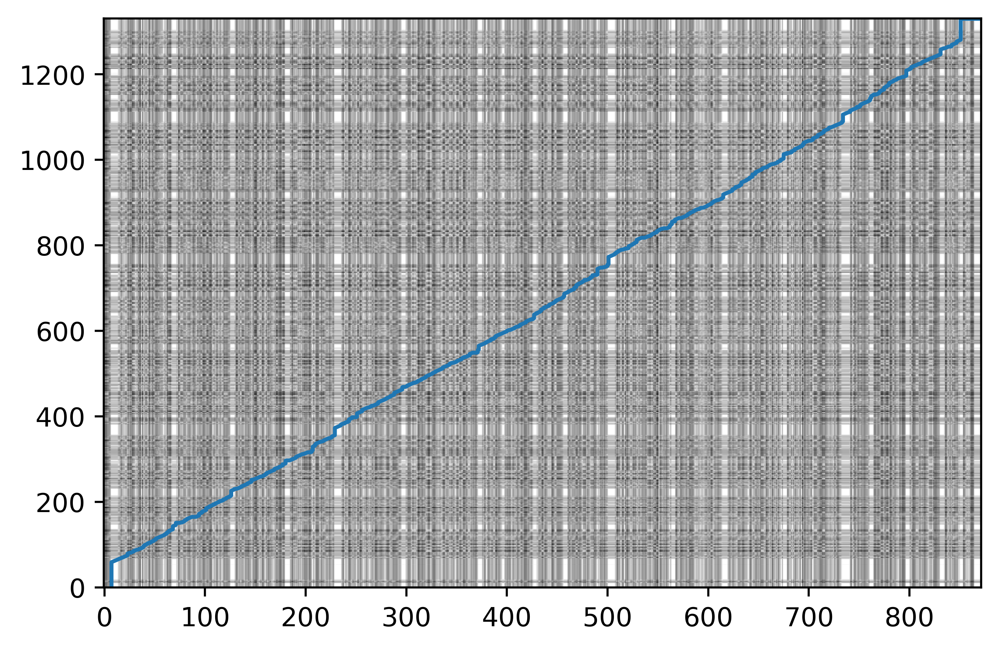

True True
3757.4015557471203


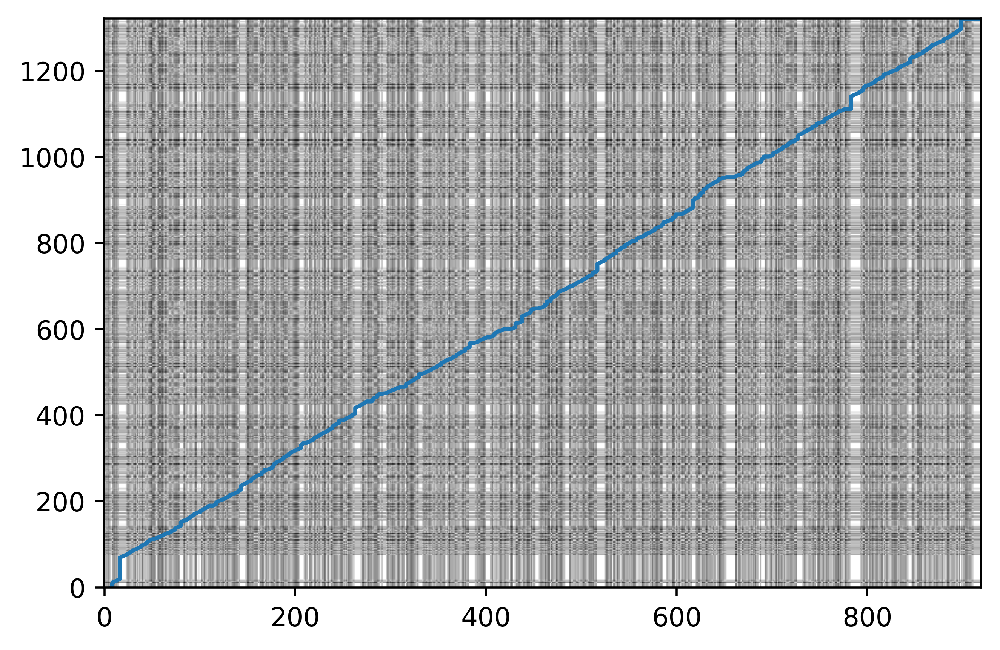

True True
3622.035691782514


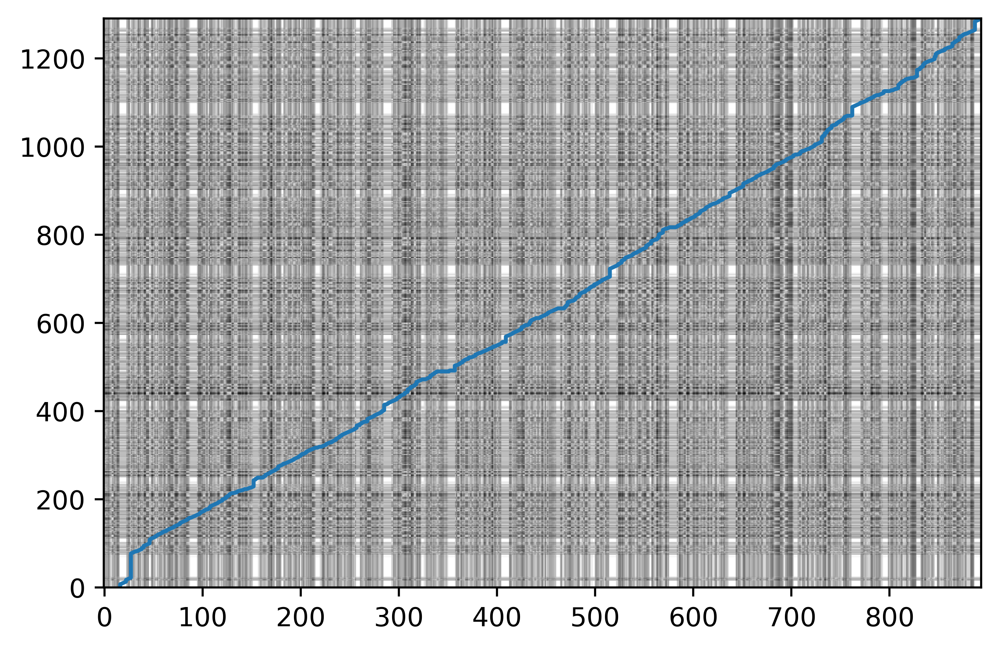

True True
p001.xhtml
f002 ('p001.mp3', 2.68)
f003 ('p001.mp3', 6.04)
f004 ('p001.mp3', 9.24)
f005 ('p001.mp3', 11.92)
f006 ('p001.mp3', 15.280000000000001)
f007 ('p001.mp3', 18.8)
f008 ('p001.mp3', 22.8)
f009 ('p001.mp3', 25.72)
f010 ('p001.mp3', 31.240000000000002)
f011 ('p001.mp3', 34.480000000000004)
f012 ('p001.mp3', 36.96)
f013 ('p001.mp3', 40.64)
f014 ('p001.mp3', 44.480000000000004)
f015 ('p001.mp3', 48.52)
p002.xhtml
f017 ('p002.mp3', 3.08)
f018 ('p002.mp3', 6.2)
f019 ('p002.mp3', 9.72)
f020 ('p002.mp3', 13.44)
f021 ('p002.mp3', 17.0)
f022 ('p002.mp3', 19.92)
f023 ('p002.mp3', 22.76)
f024 ('p002.mp3', 26.0)
f025 ('p002.mp3', 30.400000000000002)
f026 ('p002.mp3', 34.04)
f027 ('p002.mp3', 38.2)
f028 ('p002.mp3', 42.160000000000004)
f029 ('p002.mp3', 46.08)
f030 ('p002.mp3', 49.28)
p003.xhtml
f032 ('p003.mp3', 0.76)
f033 ('p003.mp3', 6.6000000000000005)
f034 ('p003.mp3', 9.96)
f035 ('p003.mp3', 12.76)
f036 ('p003.mp3', 16.88)
f037 ('p003.mp3', 20.16)
f038 ('p003.mp3', 22.92)
f039 

In [27]:
show_mapping(align('resources/tests/3_to_3/audio', 'resources/tests/3_to_3/text', 'resources/tests/3_to_3/'))

5034.794388639383


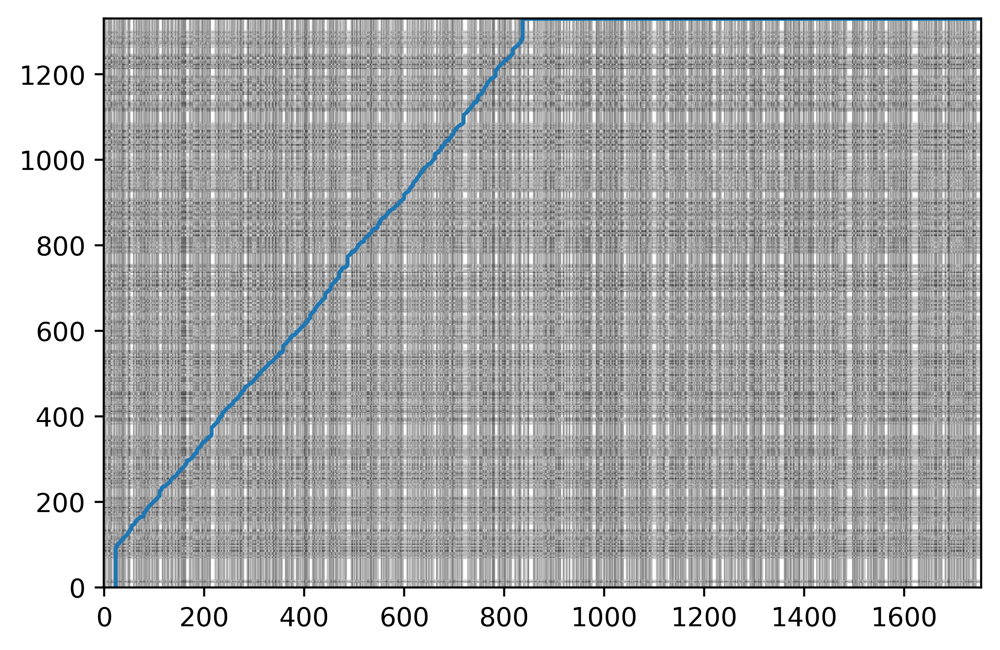

False True
3754.1094985211234


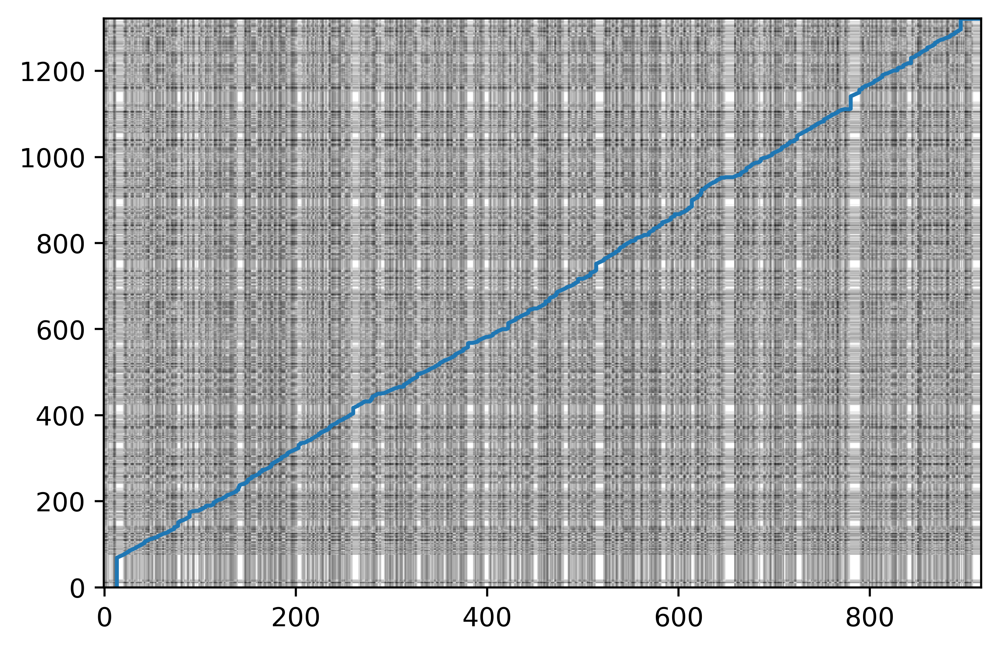

True True
3603.3859978373675


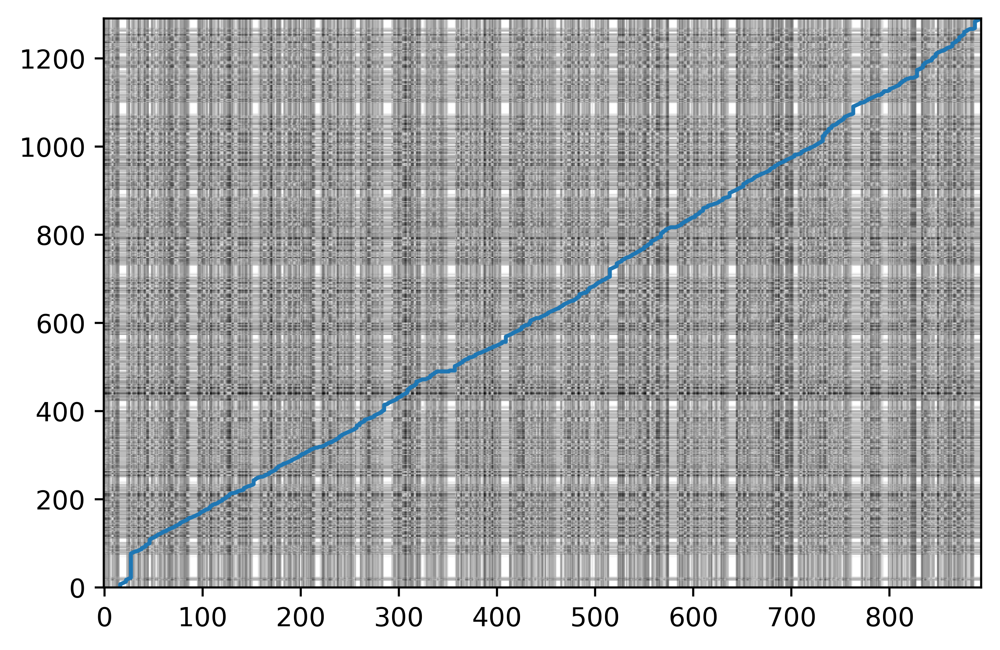

True True
p001.xhtml
f003 ('p001.mp3', 5.84)
f004 ('p001.mp3', 9.36)
f005 ('p001.mp3', 11.96)
f006 ('p001.mp3', 15.280000000000001)
f007 ('p001.mp3', 18.84)
f008 ('p001.mp3', 22.76)
f009 ('p001.mp3', 25.72)
f010 ('p001.mp3', 31.240000000000002)
f011 ('p001.mp3', 34.44)
f012 ('p001.mp3', 36.96)
f013 ('p001.mp3', 40.64)
f014 ('p001.mp3', 44.480000000000004)
f015 ('p001.mp3', 48.52)
f016 ('p002.mp3', 3.08)
f017 ('p002.mp3', 6.2)
f018 ('p002.mp3', 9.6)
f019 ('p002.mp3', 13.44)
f020 ('p002.mp3', 16.96)
f021 ('p002.mp3', 19.92)
f022 ('p002.mp3', 22.76)
f023 ('p002.mp3', 25.96)
f024 ('p002.mp3', 30.400000000000002)
f025 ('p002.mp3', 34.04)
f026 ('p002.mp3', 38.2)
f027 ('p002.mp3', 42.160000000000004)
f028 ('p002.mp3', 46.28)
f029 ('p002.mp3', 49.24)
p003.xhtml
f031 ('p003.mp3', 0.76)
f032 ('p003.mp3', 6.6000000000000005)
f033 ('p003.mp3', 10.0)
f034 ('p003.mp3', 12.76)
f035 ('p003.mp3', 16.88)
f036 ('p003.mp3', 20.12)
f037 ('p003.mp3', 22.92)
f038 ('p003.mp3', 25.52)
f039 ('p003.mp3', 29.44)


In [28]:
show_mapping(align('resources/tests/2_to_3/audio', 'resources/tests/2_to_3/text', 'resources/tests/2_to_3/'))

4099.291881333457


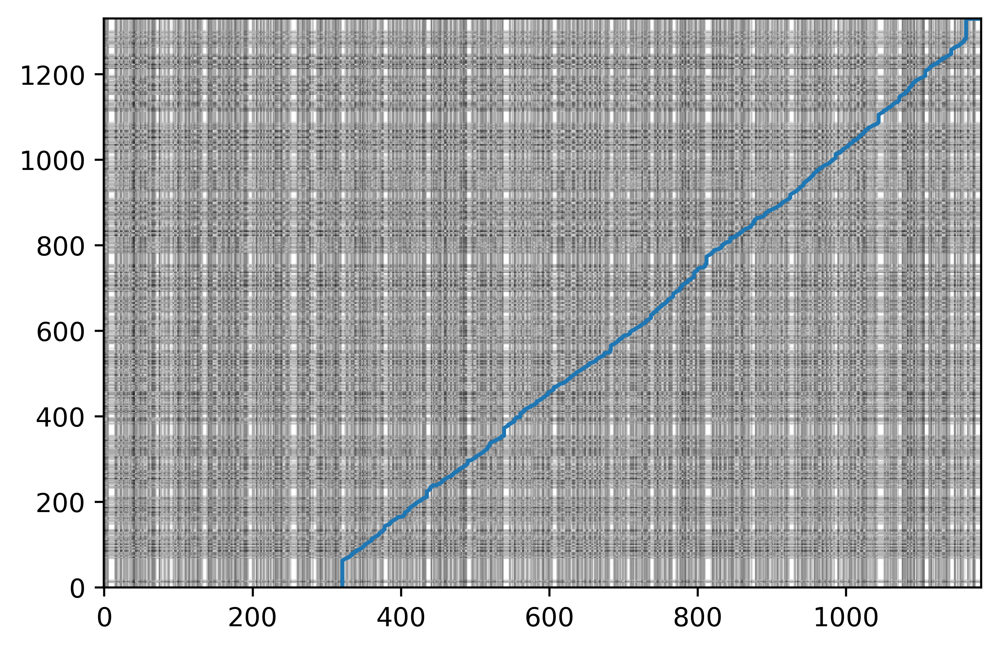

True True
p001.xhtml
f002 ('p001.mp3', 2.68)
f003 ('p001.mp3', 5.84)
f004 ('p001.mp3', 9.28)
f005 ('p001.mp3', 11.92)
f006 ('p001.mp3', 15.280000000000001)
f007 ('p001.mp3', 18.8)
f008 ('p001.mp3', 22.76)
f009 ('p001.mp3', 25.72)
f010 ('p001.mp3', 31.240000000000002)
f011 ('p001.mp3', 34.480000000000004)
f012 ('p001.mp3', 36.96)
f013 ('p001.mp3', 40.64)
f014 ('p001.mp3', 44.52)
f015 ('p001.mp3', 48.480000000000004)


In [29]:
show_mapping(align('resources/tests/text_head/audio', 'resources/tests/text_head/text', 'resources/tests/text_head/'))